In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from geopy.distance import great_circle
from shapely.geometry import MultiPoint
import plotly.express as px


In [ ]:
df = pd.read_csv('fire_data.csv')
coords = df[['LATITUDE', 'LONGITUDE']]

In [ ]:
len(df)

In [ ]:
df=df[df["STATE"]=="TX"]
len(df)

In [ ]:
lat, longg = df.LATITUDE, df.LONGITUDE

In [ ]:
plt.scatter(longg,lat)

In [ ]:
# from map can see that entire area is being covered - no point in ckustering 

In [8]:
df.columns

Index(['Unnamed: 0', 'OBJECTID', 'FOD_ID', 'FPA_ID', 'SOURCE_SYSTEM_TYPE',
       'SOURCE_SYSTEM', 'NWCG_REPORTING_AGENCY', 'NWCG_REPORTING_UNIT_ID',
       'NWCG_REPORTING_UNIT_NAME', 'SOURCE_REPORTING_UNIT',
       'SOURCE_REPORTING_UNIT_NAME', 'LOCAL_FIRE_REPORT_ID',
       'LOCAL_INCIDENT_ID', 'FIRE_CODE', 'FIRE_NAME',
       'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME', 'MTBS_ID', 'MTBS_FIRE_NAME',
       'COMPLEX_NAME', 'FIRE_YEAR', 'DISCOVERY_DATE', 'DISCOVERY_DOY',
       'DISCOVERY_TIME', 'STAT_CAUSE_CODE', 'STAT_CAUSE_DESCR', 'CONT_DATE',
       'CONT_DOY', 'CONT_TIME', 'FIRE_SIZE', 'FIRE_SIZE_CLASS', 'LATITUDE',
       'LONGITUDE', 'OWNER_CODE', 'OWNER_DESCR', 'STATE', 'COUNTY',
       'FIPS_CODE', 'FIPS_NAME', 'Shape'],
      dtype='object')

In [9]:
df_A=df[df["FIRE_SIZE_CLASS"]=="A"]

In [10]:
df_A

,Unnamed: 0,OBJECTID,FOD_ID,FPA_ID,SOURCE_SYSTEM_TYPE,SOURCE_SYSTEM,NWCG_REPORTING_AGENCY,NWCG_REPORTING_UNIT_ID,NWCG_REPORTING_UNIT_NAME,SOURCE_REPORTING_UNIT,...,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,OWNER_CODE,OWNER_DESCR,STATE,COUNTY,FIPS_CODE,FIPS_NAME,Shape
294,294,295,300,FS-1419510,FED,FS-FIRESTAT,FS,USTXTXF,National Forests And Grasslands In Texas,813,...,A,31.163056,-93.616944,5.0,USFS,TX,NaN,NaN,NaN,b'\x00\x01\xad\x10\x00\x00\xecO\x88\x04|gW\xc0...
5237,5237,5238,5262,FS-1429039,FED,FS-FIRESTAT,FS,USTXTXF,National Forests And Grasslands In Texas,813,...,A,31.350000,-95.266667,5.0,USFS,TX,NaN,NaN,NaN,b'\x00\x01\xad\x10\x00\x00P\xa5\x14\x11\x11\xd...
5238,5238,5239,5263,FS-1429040,FED,FS-FIRESTAT,FS,USTXTXF,National Forests And Grasslands In Texas,813,...,A,31.436667,-95.150556,5.0,USFS,TX,NaN,NaN,NaN,b'\x00\x01\xad\x10\x00\x00\x94\x9b\xc9\xb3\xa2...
5240,5240,5241,5265,FS-1429042,FED,FS-FIRESTAT,FS,USTXTXF,National Forests And Grasslands In Texas,813,...,A,31.271389,-93.682500,5.0,USFS,TX,NaN,NaN,NaN,b'\x00\x01\xad\x10\x00\x00D\xe1z\x14\xaekW\xc0...
5245,5245,5246,5270,FS-1429047,FED,FS-FIRESTAT,FS,USTXTXF,National Forests And Grasslands In Texas,813,...,A,30.397222,-95.165556,5.0,USFS,TX,NaN,NaN,NaN,b'\x00\x01\xad\x10\x00\x00\xbc\xf7Xv\x98\xcaW\...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1853500,1853500,1853501,300286558,SFO-2015TXLFDX552056,NONFED,ST-NASF,ST/C&L,USTXTXS,Texas A & M Forest Service,TXLFDX,...,A,35.233327,-101.866591,8.0,PRIVATE,TX,Potter,375.0,Potter,b'\x00\x01\xad\x10\x00\x00\x80\x00\x19:vwY\xc0...
1853506,1853506,1853507,300286565,SFO-2015TXLFDX578966,NONFED,ST-NASF,ST/C&L,USTXTXS,Texas A & M Forest Service,TXLFDX,...,A,35.265645,-101.814703,8.0,PRIVATE,TX,Potter,375.0,Potter,b'\x00\x01\xad\x10\x00\x00\xfc<\r\x18$tY\xc0\x...
1853507,1853507,1853508,300286567,SFO-2015TXPRI581095,NONFED,ST-NASF,ST/C&L,USTXTXS,Texas A & M Forest Service,TXPRI,...,A,35.256133,-101.638470,14.0,MISSING/NOT SPECIFIED,TX,Potter,375.0,Potter,b'\x00\x01\xad\x10\x00\x00\x88^F\xb1\xdchY\xc0...
1853508,1853508,1853509,300286568,SFO-2015TXLFDX575165,NONFED,ST-NASF,ST/C&L,USTXTXS,Texas A & M Forest Service,TXLFDX,...,A,30.308490,-104.034559,8.0,PRIVATE,TX,Presidio,377.0,Presidio,b'\x00\x01\xad\x10\x00\x00\xb4\x92\xb156\x02Z\...


In [11]:
df["FIRE_SIZE_CLASS"].value_counts()

B    91843
C    25452
A    18127
D     3782
E     1781
F      798
G      238
Name: FIRE_SIZE_CLASS, dtype: int64

In [12]:
df_A=df[df["FIRE_SIZE_CLASS"]!="A"]
len(df_A)

123894

In [13]:
lat2, longg2 = df_A.LATITUDE, df_A.LONGITUDE

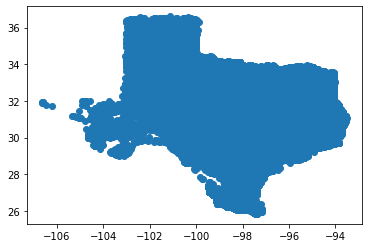

In [14]:
plt.scatter(longg2,lat2)

In [15]:
lat_long=df_A[["LATITUDE",'LONGITUDE']]

In [16]:
lat_long

,LATITUDE,LONGITUDE
283,33.786111,-96.150000
284,31.312500,-94.270833
285,33.345833,-97.595833
286,31.386667,-95.150556
287,31.354167,-95.085278
...,...,...
1856305,33.546783,-94.641417
1856360,31.031333,-97.618000
1856399,32.846100,-94.967600
1859961,33.054000,-94.708667


In [17]:
from sklearn.cluster import DBSCAN
X=lat_long.to_numpy()
#X.shape
dbscan_cluster_model=DBSCAN().fit(X)

In [18]:
df_A["cluster"]=dbscan_cluster_model.labels_

<ipython-input-18-f6392533da70>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_A["cluster"]=dbscan_cluster_model.labels_


In [19]:
df_A["cluster"].value_counts()

0    123886
1         8
Name: cluster, dtype: int64

In [20]:
lat,longg = df_A.LATITUDE, df_A.LONGITUDE

In [21]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [22]:
import plotly.express as px
fig=px.scatter(x=longg,y=lat,color=df_A["cluster"])

fig.show()

In [23]:
from sklearn.metrics import silhouette_score as ss
ss(X,df_A["cluster"])

0.5761031276124496

#### #METHOD-2 DBSCAN

In [24]:
import pandas as pd, numpy as np, matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from geopy.distance import great_circle
from shapely.geometry import MultiPoint

coords = df_A[['LATITUDE', 'LONGITUDE']]
coords=coords.to_numpy()
coords.shape

(123894, 2)

In [25]:
kms_per_radian = 6371.0088
epsilon = 4 / kms_per_radian
db = DBSCAN(eps=epsilon, min_samples=1.5, algorithm='ball_tree', metric='haversine').fit(np.radians(coords))
cluster_labels = db.labels_
unique_labels=set(cluster_labels)
num_clusters = len(set(cluster_labels))
clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])
print('Number of clusters: {}'.format(num_clusters))

Number of clusters: 1347


In [26]:
len(clusters[0])

96319

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

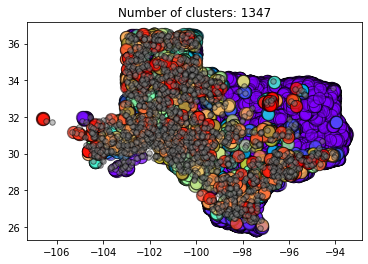

In [27]:
fig, ax = plt.subplots()
colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_labels)))
# for each cluster label and color, plot the cluster's points
for cluster_label, color in zip(unique_labels, colors):
    
    size = 150
    if cluster_label == -1: #make the noise (which is labeled -1) appear as smaller gray points
        color = 'gray'
        size = 30
    
    # plot the points that match the current cluster label
    x_coords = coords[cluster_labels==cluster_label][:,1]
    y_coords = coords[cluster_labels==cluster_label][:,0]
    ax.scatter(x=x_coords, y=y_coords, c=color, edgecolor='k', s=size, alpha=0.5)

ax.set_title('Number of clusters: {}'.format(num_clusters))
plt.show()

In [28]:
df_A["cluster"]=db.labels_

<ipython-input-28-fe98df065648>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [29]:
import plotly.express as px
fig=px.scatter(x=longg,y=lat,color=df_A["cluster"])

In [30]:
fig.show()

In [31]:
df_A["cluster"].value_counts()

 0       96319
 48       4496
 27       2179
 185      1656
-1        1495
         ...  
 906         2
 905         2
 901         2
 897         2
 1345        2
Name: cluster, Length: 1347, dtype: int64

In [32]:
df_0=df_A[df_A["cluster"]==0]

In [33]:
df_0["FIRE_SIZE_CLASS"].value_counts()

B    74019
C    19329
D     2033
E      674
F      216
G       48
Name: FIRE_SIZE_CLASS, dtype: int64

In [34]:
len(x_coords)

1495

In [35]:
kms_per_radian = 6371.0088
epsilon = 1.5 / kms_per_radian
db = DBSCAN(eps=epsilon, min_samples=1, algorithm='ball_tree', metric='haversine').fit(np.radians(coords))
cluster_labels = db.labels_
num_clusters = len(set(cluster_labels))
clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])

In [36]:
def get_centermost_point(cluster):
    centroid = (MultiPoint(cluster).centroid.x, MultiPoint(cluster).centroid.y)
    centermost_point = min(cluster, key=lambda point: great_circle(point, centroid).m)
    return tuple(centermost_point)
centermost_points = clusters.map(get_centermost_point)


In [37]:
centermost_points

0              (33.78254, -96.14426)
1             (31.31833333, -94.255)
2                   (33.34, -97.595)
3        (31.38722222, -95.15416667)
4        (31.36666667, -95.07944444)
                    ...             
22825           (33.8842, -99.36326)
22826      (30.5584177, -97.6931791)
22827      (30.7323807, -97.6145968)
22828       (33.216287, -102.812462)
22829     (35.2650758, -101.7493374)
Length: 22830, dtype: object

### Kmeans

In [38]:
from sklearn.cluster import KMeans
from collections import Counter

In [39]:
X=df_A.loc[:,['LATITUDE','LONGITUDE']]

In [40]:
kmeans = KMeans(n_clusters=1840, random_state=0).fit(X)

In [41]:
df_A["cluster2"]=kmeans.labels_

<ipython-input-41-dcd0a313be44>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [42]:
import plotly.express as px
fig=px.scatter(x=longg,y=lat,color=df_A["cluster2"])

In [43]:
fig.show()

In [44]:
a=kmeans.cluster_centers_

In [45]:
fs_kmeans=pd.DataFrame(a)
fs_kmeans.rename(columns={"0":"Latitude","1":"Longitude"},inplace=True)
fs_kmeans.set_axis(["Latitude","Longitude"],axis='columns',inplace=True)

<ipython-input-45-73f5885d5d44>:3: FutureWarning:

DataFrame.set_axis 'inplace' keyword is deprecated and will be removed in a future version. Use `obj = obj.set_axis(..., copy=False)` instead



In [46]:
fs_kmeans

,Latitude,Longitude
0,30.608424,-104.054505
1,31.994355,-96.658777
2,29.856362,-97.025731
3,35.376603,-100.206197
4,33.156632,-94.166202
...,...,...
1835,36.025008,-102.946551
1836,35.416968,-102.471758
1837,30.577577,-94.271695
1838,32.724142,-100.970356


In [47]:
firestation=pd.read_csv("firestations_f.csv")
firestation

,FireDepartmentId,Name,TypeId,County,PhysicalCity,PhysicalState,PhysicalZipCode,PhysicalAddress1,PhysicalAddress2,Latitude,...,CharterId,CharterType,Legacy_VFDId,TESRS,IsAssistanceOnHold,EstablishmentYear,PrimaryProtectionAreaSqMile,CreatedDate,LastVerifiedDate,LastVerifiedBy
0,711,2604 VFD,VFD,Hill,Whitney,TX,76692,319 FM 2604,NaN,32.010900,...,41347601.0,Department,2510.0,NaN,0.0,1977.0,42.0,8/14/2017 15:09,12/7/2020 16:48,4328.0
1,1696,287 R/C Fire & Rescue,Combination/Part Paid,Navarro,Corsicana,TX,75109,9854 S Hwy 287,NaN,31.997800,...,800321607.0,Department,4177.0,NaN,0.0,2004.0,90.0,2/2/2018 16:31,9/6/2022 9:37,7936.0
2,246,356 VFD,VFD,Trinity,Trinity,TX,75862,12427 FM 356,NaN,30.870400,...,64714301.0,Department,985.0,NaN,0.0,1989.0,60.0,3/15/2018 15:35,5/4/2022 16:19,145.0
3,1032,84 East VFD,Combination/Part Paid,Anderson,Palestine,TX,75801,2254 ACR 385,NaN,31.746636,...,58085601.0,Department,2960.0,NaN,0.0,1982.0,95.0,4/6/2018 13:19,11/12/2020 9:56,829.0
4,1644,980 North VFD,Combination/Part Paid,San Jacinto,Huntsville,TX,77320,30 Lakeside Drive,NaN,30.860360,...,117550401.0,Department,4004.0,NaN,0.0,1990.0,17.0,5/4/2016 12:16,3/1/2021 14:40,281.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1835,69,Yorktown VFD,VFD,DeWitt,Yorktown,TX,78164,107 W. Main,NaN,28.979400,...,0.0,City,283.0,103.0,0.0,NaN,176.0,12/13/2017 17:33,2/22/2022 19:32,7758.0
1836,1805,Ysleta del Sur Pueblo Fire Department,Combination/Part Paid,El Paso,El Paso,TX,79927,1100 Santos Sanchez suite B,NaN,31.687554,...,NaN,NaN,4541.0,NaN,1.0,NaN,NaN,5/28/2014 16:20,1/5/2021 16:14,6554.0
1837,623,Zapata County Fire Department,Combination/Part Paid,Zapata,Zapata,TX,78076,305 FM 496 E,NaN,26.905600,...,0.0,County,2374.0,NaN,0.0,NaN,1059.0,9/19/2014 15:34,7/3/2022 15:38,439.0
1838,1453,Zavalla VFD,VFD,Angelina,Zavalla,TX,75980,174 park Street,NaN,31.158442,...,4032301.0,Department,3546.0,NaN,0.0,1977.0,180.0,8/3/2015 12:18,12/2/2020 11:34,281.0


In [48]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

<AxesSubplot: >

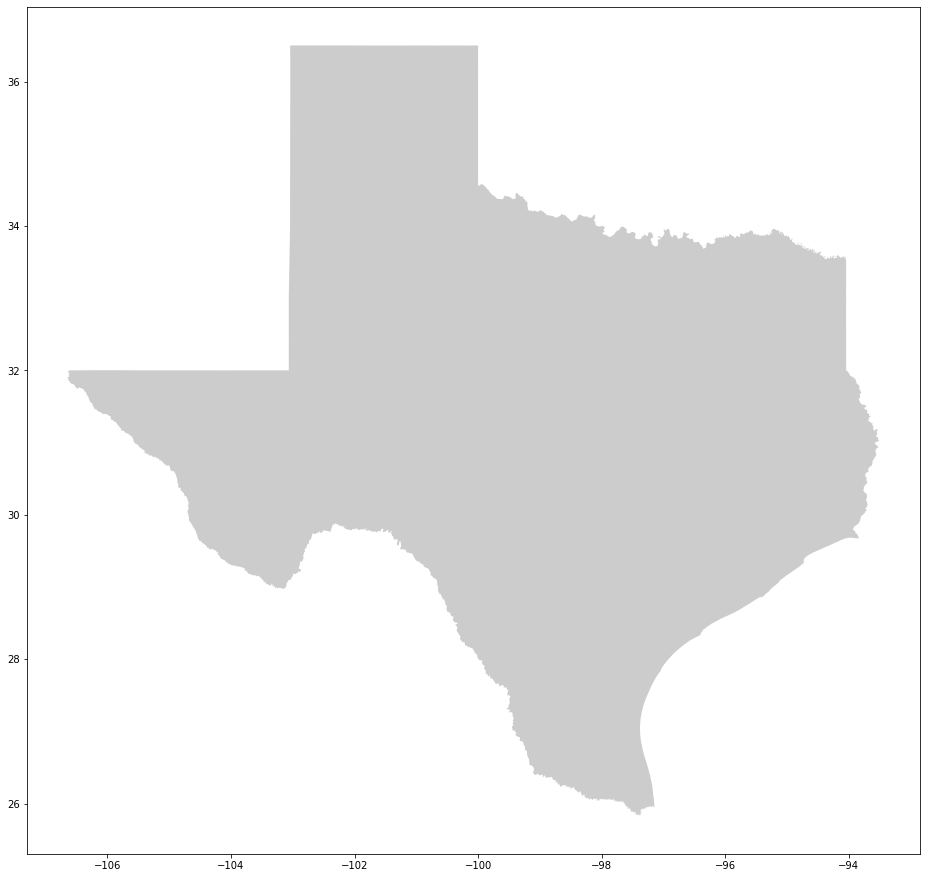

In [49]:
texas = gpd.read_file("Texas_State_Boundary/State.shp")
crs = {'init': 'epsg:4326'}
fig, ax = plt.subplots(figsize = (16,16))
texas.plot(ax=ax, alpha = 0.4, color='grey')

C:\Users\ishan\anaconda3\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6

C:\Users\ishan\anaconda3\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


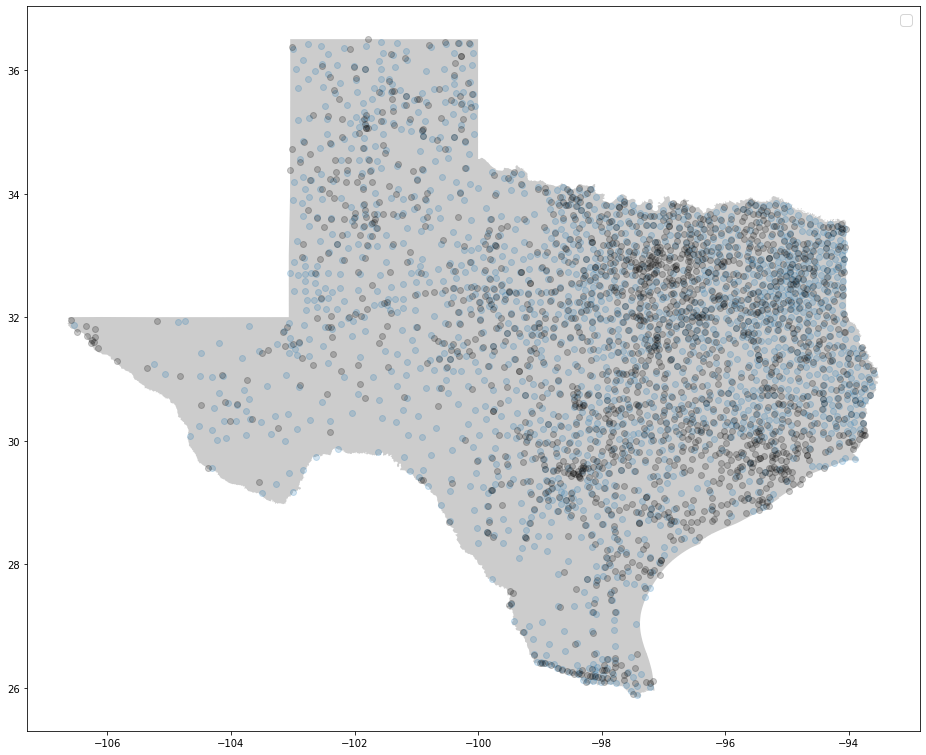

In [50]:
geometry = [Point(xy) for xy in zip(fs_kmeans["Longitude"],fs_kmeans["Latitude"])]
geo_df = gpd.GeoDataFrame(fs_kmeans,crs=crs,geometry = geometry)
geometry2 = [Point(xy) for xy in zip(firestation["Longitude"],firestation["Latitude"])]
geo_df2 = gpd.GeoDataFrame(firestation,crs=crs,geometry = geometry2)
fig, ax = plt.subplots(figsize = (16,16))
texas.plot(ax=ax, alpha = 0.4, color='grey')
geo_df.plot(ax=ax,aspect=1, alpha=0.2)
geo_df2.plot(ax=ax,aspect=1, alpha=0.2,color="black")
plt.legend(prop={'size':15})


### Response Time Calculation

In [51]:
#Response time
#Number of fires which were repsonded from at least one station within 4,6,8 mins
#assumption is that speed of vehicles is 60 km/hr

In [52]:
len(df) ## all fire Incidents in texas ( dosen't matter year as it can happpen again)

142021

In [53]:
len(firestation) #main firestations

1840

In [54]:
# calculating distance between them and then based on time threshold identifying which fire were responded within time

##### M-1 Euclidean (fast and vectorized but not accurate over long distances)

In [55]:
df_firestation=firestation[['FireDepartmentId', 'Name', 'TypeId', 'County', 'PhysicalCity',
       'PhysicalState','Latitude', 'Longitude','EstablishmentYear']]

In [56]:
df.columns

Index(['Unnamed: 0', 'OBJECTID', 'FOD_ID', 'FPA_ID', 'SOURCE_SYSTEM_TYPE',
       'SOURCE_SYSTEM', 'NWCG_REPORTING_AGENCY', 'NWCG_REPORTING_UNIT_ID',
       'NWCG_REPORTING_UNIT_NAME', 'SOURCE_REPORTING_UNIT',
       'SOURCE_REPORTING_UNIT_NAME', 'LOCAL_FIRE_REPORT_ID',
       'LOCAL_INCIDENT_ID', 'FIRE_CODE', 'FIRE_NAME',
       'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME', 'MTBS_ID', 'MTBS_FIRE_NAME',
       'COMPLEX_NAME', 'FIRE_YEAR', 'DISCOVERY_DATE', 'DISCOVERY_DOY',
       'DISCOVERY_TIME', 'STAT_CAUSE_CODE', 'STAT_CAUSE_DESCR', 'CONT_DATE',
       'CONT_DOY', 'CONT_TIME', 'FIRE_SIZE', 'FIRE_SIZE_CLASS', 'LATITUDE',
       'LONGITUDE', 'OWNER_CODE', 'OWNER_DESCR', 'STATE', 'COUNTY',
       'FIPS_CODE', 'FIPS_NAME', 'Shape'],
      dtype='object')

In [57]:
df=df.reset_index()

In [58]:
from scipy.spatial import distance
coords=[(df["LATITUDE"][i],df["LONGITUDE"][i]) for i,v in df.iterrows()]
coords2=[(firestation["Latitude"][i],firestation["Longitude"][i]) for i,v in firestation.iterrows()]

DIST=distance.cdist(coords, coords2, 'euclidean')

In [59]:
DIST=DIST*111

In [60]:
np.min(DIST[0])

13.829405832849108

In [61]:
min_dist=[]
for i in range(len(DIST)):
    min_dist.append((np.min(DIST[i]),np.where(DIST[i]==np.min(DIST[i]))[0][0]))

In [62]:
min_dist

[(13.829405832849108, 1617),
 (0.6602794173192847, 188),
 (10.945492917675482, 32),
 (1.6272718412286638, 1347),
 (6.400193250052316, 1740),
 (2.3528630317768995, 1655),
 (2.2676814398354046, 1655),
 (2.1487057605611875, 1655),
 (1.2824532566530784, 1655),
 (2.254101418958392, 1655),
 (2.240000536163876, 1655),
 (5.184526762613689, 1347),
 (5.48225555958883, 291),
 (7.380511643244281, 291),
 (4.845983944090081, 32),
 (6.5501000487053815, 32),
 (26.84985563545857, 415),
 (9.01577982229929, 842),
 (5.184526762613689, 1347),
 (3.2782038650907124, 95),
 (6.292530980610154, 562),
 (3.0173675733497833, 1190),
 (4.406965201694525, 1366),
 (9.741352272067578, 1366),
 (7.039600213851081, 1090),
 (5.375867817421368, 95),
 (8.054340498909708, 1347),
 (3.319516927962319, 95),
 (7.048276854506727, 469),
 (8.292799033562247, 469),
 (12.522758718514572, 188),
 (6.793088638446011, 1147),
 (11.393166277849186, 1838),
 (13.18931771149397, 188),
 (13.18931771149397, 188),
 (7.717458973874605, 855),
 (11.

In [63]:
# now grouping based on firestations - to see which firestation ideally would have responded the most.

In [64]:
firestation.columns

Index(['FireDepartmentId', 'Name', 'TypeId', 'County', 'PhysicalCity',
       'PhysicalState', 'PhysicalZipCode', 'PhysicalAddress1',
       'PhysicalAddress2', 'Latitude', 'Longitude', 'MailAddress1',
       'MailAddress2', 'MailCity', 'MailState', 'MailZipCode', 'Phone', 'Fax',
       'Website', 'PaidPersonnel', 'PartPaidPersonnel', 'VolunteerPersonnel',
       'ActiveVolunteerPersonnel', 'AdminStaffPersonnel',
       'VolunteerAdminStaffPersonnel', 'EmergencyServiceDistrict',
       'PrimaryStationName', 'FdId', 'Ssfma', 'TfsCaseNumber', 'TaxId',
       'CommissionId', 'CharterId', 'CharterType', 'Legacy_VFDId', 'TESRS',
       'IsAssistanceOnHold', 'EstablishmentYear',
       'PrimaryProtectionAreaSqMile', 'CreatedDate', 'LastVerifiedDate',
       'LastVerifiedBy', 'geometry'],
      dtype='object')

##### Case-1
calculating those fires whose minimum distance from each firestation is beyond threshold. 
in case of emergency assuming speed of firetrucks to be 90 kmh if response time is 4mins then max distance: 90*4/60 = 6km 

In [65]:
# now grouping based on firestations - to see which firestation ideally would have responded the most.

In [66]:
respond_count=[]
for i,v in df_firestation.iterrows():
    count=0
    for j in range(len(min_dist)):
        if min_dist[j][1]==i:
            count+=1
    respond_count.append(count)

In [67]:
df_firestation_euclidean_wo_est_year=df_firestation.copy(deep=True)
df_firestation_euclidean_wo_est_year["Respond COUNT"]=respond_count

In [68]:
fig = px.bar(df_firestation_euclidean_wo_est_year, x='FireDepartmentId', y='Respond COUNT')
fig.show()

In [69]:
#identifying those records having distance greater than 6 km
f_beyond={}
#target_dist based on time
target_dist=[(90*4)/60,(90*5)/60,(90*6)/60,(90*7)/60,(90*8)/60,(90*9)/60,(90*10)/60,(90*11)/60,(90*12)/60,(90*13)/60,(90*14)/60,(90*15)/60]
for j in range(len(target_dist)):
    firepoints=[]
    for i in range(len(min_dist)):
        if min_dist[i][0]>target_dist[j]:
            firepoints.append(i)
    f_beyond[j]=firepoints

In [70]:
count=[len(f_beyond[a]) for a in f_beyond.keys()]

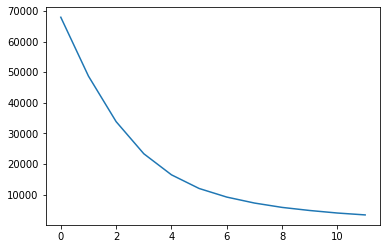

In [71]:
plt.plot(count)

In [72]:
# Now based on the domain knowledge we can identify how the response time is varying. Also generally ideal respond time is 6 mins. 
# so based on this around 33851 fire_incidents are being responded beyond 6 min standard. So we will try to create a cluster
# to identify optimum firestation location during this time using DBSCAN.

In [73]:
#(f_beyond[2])
df["beyond_6_mins"]=""
for i,v in df.iterrows():
    if i in f_beyond[2]:
        df["beyond_6_mins"][i]=1

<ipython-input-73-8e4b65b65665>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [81]:
df["beyond_8_mins"]=""
for i,v in df.iterrows():
    if i in f_beyond[4]:
        df["beyond_8_mins"][i]=1

<ipython-input-81-5aeea21a9ca8>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [82]:
df_beyond8=df[df["beyond_8_mins"]==1]
df_beyond8.columns

Index(['index', 'Unnamed: 0', 'OBJECTID', 'FOD_ID', 'FPA_ID',
       'SOURCE_SYSTEM_TYPE', 'SOURCE_SYSTEM', 'NWCG_REPORTING_AGENCY',
       'NWCG_REPORTING_UNIT_ID', 'NWCG_REPORTING_UNIT_NAME',
       'SOURCE_REPORTING_UNIT', 'SOURCE_REPORTING_UNIT_NAME',
       'LOCAL_FIRE_REPORT_ID', 'LOCAL_INCIDENT_ID', 'FIRE_CODE', 'FIRE_NAME',
       'ICS_209_INCIDENT_NUMBER', 'ICS_209_NAME', 'MTBS_ID', 'MTBS_FIRE_NAME',
       'COMPLEX_NAME', 'FIRE_YEAR', 'DISCOVERY_DATE', 'DISCOVERY_DOY',
       'DISCOVERY_TIME', 'STAT_CAUSE_CODE', 'STAT_CAUSE_DESCR', 'CONT_DATE',
       'CONT_DOY', 'CONT_TIME', 'FIRE_SIZE', 'FIRE_SIZE_CLASS', 'LATITUDE',
       'LONGITUDE', 'OWNER_CODE', 'OWNER_DESCR', 'STATE', 'COUNTY',
       'FIPS_CODE', 'FIPS_NAME', 'Shape', 'beyond_6_mins', 'beyond_8_mins'],
      dtype='object')

In [83]:
########### NOW APPLYING Kmeans ON THESE POINTS in epsilon will specify the distance in km ##############

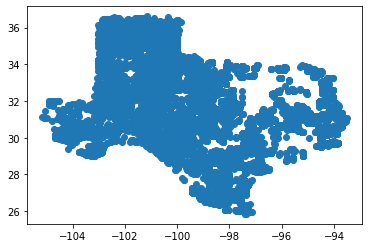

In [127]:
lat, longg = df_beyond8.LATITUDE, df_beyond8.LONGITUDE
plt.scatter(longg,lat)

In [128]:
df_beyond8AB=df_beyond8[df_beyond8["FIRE_SIZE_CLASS"]!='A']
df_beyond8AB=df_beyond8[df_beyond8["FIRE_SIZE_CLASS"]!='B']

In [363]:
X=df_beyond8AB.loc[:,['LATITUDE','LONGITUDE']]
kmeans = KMeans(n_clusters=50, init="k-means++", n_init=1000).fit(X)
df_beyond8AB["cluster2"]=kmeans.labels_

<ipython-input-363-c22294a46d0f>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [364]:
lat2, longg2 = df_beyond8AB.LATITUDE, df_beyond8AB.LONGITUDE
import plotly.express as px
fig=px.scatter(x=longg2,y=lat2,color=df_beyond8AB["cluster2"])

In [365]:
df_beyond8AB["FIRE_SIZE_CLASS"].value_counts()

C    4278
A    1561
D    1178
E     738
F     432
G     155
Name: FIRE_SIZE_CLASS, dtype: int64

In [366]:
fig.show()

In [367]:
X2=df_beyond8AB.loc[:,['LATITUDE','LONGITUDE']]
distortions = []
K = range(2,50)
for k in K:
    kmeanModel = KMeans(n_clusters=k, random_state=0).fit(X2)
    #kmeanModel = KMeans(n_clusters=k).fit(X)
    distortions.append(kmeanModel.inertia_)

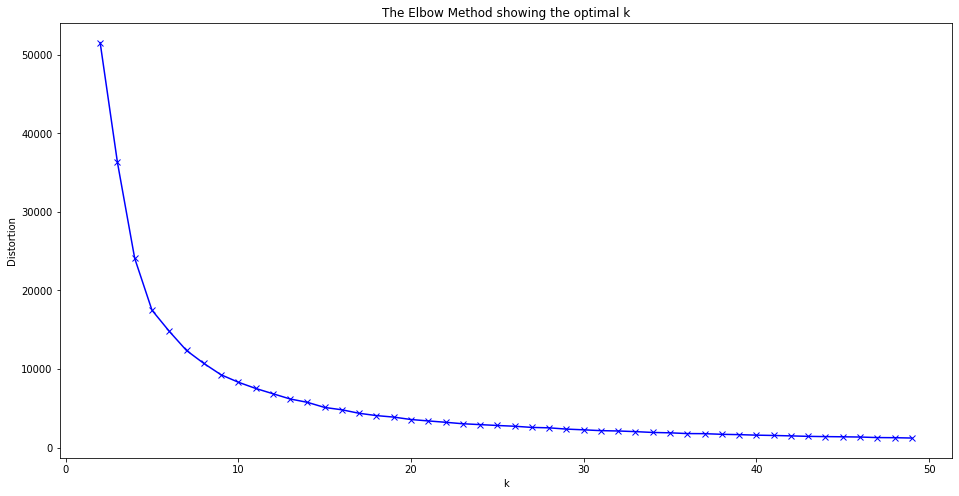

In [368]:
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [369]:
b=kmeans.cluster_centers_
kmean_centers=pd.DataFrame(b)
kmean_centers.rename(columns={"0":"Latitude","1":"Longitude"},inplace=True)
kmean_centers.set_axis(["Latitude","Longitude"],axis='columns',inplace=True)

<ipython-input-369-00f4970f8384>:4: FutureWarning:

DataFrame.set_axis 'inplace' keyword is deprecated and will be removed in a future version. Use `obj = obj.set_axis(..., copy=False)` instead



In [370]:
kmean_centers

,Latitude,Longitude
0,30.100126,-99.741519
1,33.001874,-100.196704
2,31.059841,-94.197962
3,30.411891,-102.933310
4,36.031253,-102.592914
5,28.251939,-97.965769
6,31.445225,-98.053267
7,32.245135,-102.165689
8,35.943649,-100.338571
9,33.697199,-97.543242


In [371]:
from scipy.spatial import distance
coords_km=[(kmean_centers["Latitude"][i],kmean_centers["Longitude"][i]) for i,v in kmean_centers.iterrows()]
coords2_fire=[(df_beyond8AB["LATITUDE"][i],df_beyond8AB["LONGITUDE"][i]) for i,v in df_beyond8AB.iterrows()]

DIST_KM=distance.cdist(coords2_fire, coords_km, 'euclidean')*111

In [372]:
at=[]
for i in range(len(DIST_KM)):
    at.append(np.min(DIST_KM[i]))

In [373]:
at

[35.05409795667485,
 16.486680564417107,
 16.170717256736808,
 16.337414856151614,
 21.706919564929073,
 87.06201657728512,
 44.77843369642221,
 13.983915179641892,
 16.869795283395728,
 4.472434297435898,
 9.893986118459376,
 13.813293866250941,
 9.399339267804114,
 6.079994910044982,
 4.285377526156472,
 4.211687781879405,
 4.052953836782631,
 35.04994017271903,
 17.178042342920556,
 32.744505908914476,
 22.566096242887138,
 12.59069213667616,
 9.630431532344513,
 8.675571885937153,
 33.13013069580645,
 30.701998644538843,
 51.23322730033881,
 40.560793039360334,
 41.68474902007384,
 30.84446342320183,
 40.59958786281685,
 26.44948104821867,
 49.57192961610805,
 86.95999862249253,
 35.099796762229005,
 8.871741249190535,
 59.189772363020786,
 54.47132862471395,
 35.51977011050848,
 19.342975758873887,
 30.37333122127515,
 41.22945014746454,
 24.4372081675784,
 15.719915044902233,
 23.15440222104433,
 32.59947911938684,
 28.552494215598575,
 27.206313822485793,
 24.626661836664173,
 3

In [375]:
c=0
for i in at:
    if i<=30:
        c+=1
print(c/len(at))

0.4075761208343323


In [321]:
np.min(DIST_KM[0])

35.54690523936738